## Trigger Word Detection


<a name='0'></a>
## Packages

In [2]:
!pip install pydub

In [3]:
import numpy as np
from pydub import AudioSegment
import random
import sys
import io
import os
import glob
import IPython
from td_utils import *
%matplotlib inline

C:\Users\DELL\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\pydub\utils.py:170: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)


<a name='1'></a>
## 1 - Data synthesis: Creating a Speech Dataset 

Let's start by building a dataset for your trigger word detection algorithm. 
* A speech dataset should ideally be as close as possible to the application you will want to run it on. 
* In this case, we'd like to detect the word "activate" in working environments (library, home, offices, open-spaces ...). 
* Therefore, we need to create recordings with a mix of positive words ("activate") and negative words (random words other than activate) on different background sounds. Let's create such a dataset. 


In [4]:
IPython.display.Audio("./raw_data/activates/1.wav")

In [5]:
IPython.display.Audio("./raw_data/negatives/4.wav")

In [6]:
IPython.display.Audio("./raw_data/backgrounds/1.wav")

We will use these three types of recordings (positives/negatives/backgrounds) to create a labeled dataset.


### From Audio Recordings to Spectrograms

What really is an audio recording? 
* A microphone records little variations in air pressure over time, and it is these little variations in air pressure that your ear also perceives as sound. 
* We can think of an audio recording as a long list of numbers measuring the little air pressure changes detected by the microphone. 
* We will use audio sampled at 44100 Hz (or 44100 Hertz). 
    * This means the microphone gives us 44,100 numbers per second. 
    * Thus, a 10 second audio clip is represented by 441,000 numbers (= $10 \times 44,100$). 

#### Spectrogram
* It is quite difficult to figure out from this "raw" representation of audio whether the word "activate" was said. 
* In order to help our sequence model more easily learn to detect trigger words, we will compute a *spectrogram* of the audio. 
* The spectrogram tells us how much different frequencies are present in an audio clip at any moment in time. 
    * A spectrogram is computed by sliding a window over the raw audio signal, and calculating the most active frequencies in each window using a Fourier transform. 
   

Let's look at an example. 

In [7]:
IPython.display.Audio("audio_examples/example_train.wav")

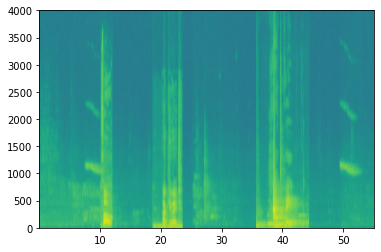

In [8]:
x = graph_spectrogram("audio_examples/example_train.wav")

The graph above represents how active each frequency is (y axis) over a number of time-steps (x axis). 

<img src="images/spectrogram.png" style="width:500px;height:200px;">
<center> **Figure 1**: Spectrogram of an audio recording </center>


* The color in the spectrogram shows the degree to which different frequencies are present (loud) in the audio at different points in time. 
* Green means a certain frequency is more active or more present in the audio clip (louder).
* Blue squares denote less active frequencies.
* The dimension of the output spectrogram depends upon the hyperparameters of the spectrogram software and the length of the input. 

In [9]:
_, data = wavfile.read("audio_examples/example_train.wav")
print("Time steps in audio recording before spectrogram", data[:,0].shape)
print("Time steps in input after spectrogram", x.shape)

Time steps in audio recording before spectrogram (441000,)
Time steps in input after spectrogram (101, 5511)


Now, we can define:

In [46]:
Tx = 5511 # The number of time steps input to the model from the spectrogram
n_freq = 101 # Number of frequencies input to the model at each time step of the spectrogram

#### Dividing into time-intervals
Note that we may divide a 10 second interval of time with different units (steps).
* Raw audio divides 10 seconds into 441,000 units.
* A spectrogram divides 10 seconds into 5,511 units.
    * $T_x = 5511$
* We will use a Python module `pydub` to synthesize audio, and it divides 10 seconds into 10,000 units.
* The output of our model will divide 10 seconds into 1,375 units.
    * $T_y = 1375$
    * For each of the 1375 time steps, the model predicts whether someone recently finished saying the trigger word "activate". 
* All of these are hyperparameters and can be changed (except the 441000, which is a function of the microphone). 
* We have chosen values that are within the standard range used for speech systems.

In [10]:
Ty = 1375 # The number of time steps in the output of our model


### Generating a Single Training Example

#### Benefits of synthesizing data
Because speech data is hard to acquire and label, you will synthesize your training data using the audio clips of activates, negatives, and backgrounds. 
* It is quite slow to record lots of 10 second audio clips with random "activates" in it. 
* Instead, it is easier to record lots of positives and negative words, and record background noise separately (or download background noise from free online sources). 

#### Process for Synthesizing an audio clip
* To synthesize a single training example, you will:
    - Pick a random 10 second background audio clip
    - Randomly insert 0-4 audio clips of "activate" into this 10 sec. clip
    - Randomly insert 0-2 audio clips of negative words into this 10 sec. clip
* Because you had synthesized the word "activate" into the background clip, you know exactly when in the 10 second clip the "activate" makes its appearance. 
    * We'll see later that this makes it easier to generate the labels $y^{\langle t \rangle}$ as well. 


In [11]:
# Load audio segments using pydub 
activates, negatives, backgrounds = load_raw_audio('./raw_data/')

print("background len should be 10,000, since it is a 10 sec clip\n" + str(len(backgrounds[0])),"\n")
print("activate[0] len may be around 1000, since an `activate` audio clip is usually around 1 second (but varies a lot) \n" + str(len(activates[0])),"\n")
print("activate[1] len: different `activate` clips can have different lengths\n" + str(len(activates[1])),"\n")

background len should be 10,000, since it is a 10 sec clip
10000 

activate[0] len may be around 1000, since an `activate` audio clip is usually around 1 second (but varies a lot) 
721 

activate[1] len: different `activate` clips can have different lengths
731 



#### Overlaying positive/negative 'word' audio clips on top of the background audio

* Given a 10 second background clip and a short audio clip containing a positive or negative word, you need to be able to "add" the word audio clip on top of the background audio.
* We will be inserting multiple clips of positive/negative words into the background, and we don't want to insert an "activate" or a random word somewhere that overlaps with another clip we had previously added. 
    * To ensure that the 'word' audio segments do not overlap when inserted, we will keep track of the times of previously inserted audio clips. 
* To be clear, when we insert a 1 second "activate" onto a 10 second clip of cafe noise, **you do not end up with an 11 sec clip.** 
    * The resulting audio clip is still 10 seconds long.
    * we'll see later how pydub allows us to do this. 

#### Label the positive/negative words
* Recall that the labels $y^{\langle t \rangle}$ represent whether or not someone has just finished saying "activate". 
    * $y^{\langle t \rangle} = 1$ when that clip has finished saying "activate".
    * Given a background clip, we can initialize $y^{\langle t \rangle}=0$ for all $t$, since the clip doesn't contain any "activate". 
* When we insert or overlay an "activate" clip, you will also update labels for $y^{\langle t \rangle}$.
    * Rather than updating the label of a single time step, we will update 50 steps of the output to have target label 1. 
    * Recall from the lecture on trigger word detection that updating several consecutive time steps can make the training data more balanced.
* we train a GRU (Gated Recurrent Unit) to detect when someone has **finished** saying "activate". 

##### Example
* Suppose the synthesized "activate" clip ends at the 5 second mark in the 10 second audio - exactly halfway into the clip. 
* Recall that $T_y = 1375$, so timestep $687 = $ `int(1375*0.5)` corresponds to the moment 5 seconds into the audio clip. 
* Set $y^{\langle 688 \rangle} = 1$. 
* We will allow the GRU to detect "activate" anywhere within a short time-internal **after** this moment, so we actually **set 50 consecutive values** of the label $y^{\langle t \rangle}$ to 1. 
    * Specifically, we have $y^{\langle 688 \rangle} = y^{\langle 689 \rangle} = \cdots = y^{\langle 737 \rangle} = 1$.  



#### Visualizing the labels
* Here's a figure illustrating the labels $y^{\langle t \rangle}$ in a clip.
    * We have inserted "activate", "innocent", "activate", "baby." 
    * Note that the positive labels "1" are associated only with the positive words. 

<img src="images/label_diagram.png" style="width:500px;height:200px;">
<center> **Figure 2** </center>



#### Helper functions

To implement the training set synthesis process, we will use the following helper functions. 
* All of these functions will use a 1ms discretization interval
* The 10 seconds of audio is always discretized into 10,000 steps. 


1. `get_random_time_segment(segment_ms)`
    * Retrieves a random time segment from the background audio.
2. `is_overlapping(segment_time, existing_segments)`
    * Checks if a time segment overlaps with existing segments
3. `insert_audio_clip(background, audio_clip, existing_times)`
    * Inserts an audio segment at a random time in the background audio
    * Uses the functions `get_random_time_segment` and `is_overlapping`
4. `insert_ones(y, segment_end_ms)`
    * Inserts additional 1's into the label vector y after the word "activate"

#### Get a random time segment

* The function `get_random_time_segment(segment_ms)` returns a random time segment onto which we can insert an audio clip of duration `segment_ms`. 


In [12]:
def get_random_time_segment(segment_ms):
    """
    Gets a random time segment of duration segment_ms in a 10,000 ms audio clip.
    
    Arguments:
    segment_ms -- the duration of the audio clip in ms ("ms" stands for "milliseconds")
    
    Returns:
    segment_time -- a tuple of (segment_start, segment_end) in ms
    """
    
    segment_start = np.random.randint(low=0, high=10000-segment_ms)   # Make sure segment doesn't run past the 10sec background 
    segment_end = segment_start + segment_ms - 1
    
    return (segment_start, segment_end)

### Implement is_overlapping function

In [13]:

def is_overlapping(segment_time, previous_segments):
    """
    Checks if the time of a segment overlaps with the times of existing segments.
    
    Arguments:
    segment_time -- a tuple of (segment_start, segment_end) for the new segment
    previous_segments -- a list of tuples of (segment_start, segment_end) for the existing segments
    
    Returns:
    True if the time segment overlaps with any of the existing segments, False otherwise
    """
    
    segment_start, segment_end = segment_time
    
    #Initialize overlap as a "False" flag. 
    overlap = False
    
    #loop over the previous_segments start and end times.
    # Compare start/end times and set the flag to True if there is an overlap 
    for previous_start, previous_end in previous_segments:
        if segment_start <= previous_end and segment_end >= previous_start:
            overlap = True
            break

    return overlap

In [15]:

def is_overlapping_test(target):
    assert target((670, 1430), []) == False, "Overlap with an empty list must be False"
    assert target((500, 1000), [(100, 499), (1001, 1100)]) == False, "Almost overlap, but still False"
    assert target((750, 1250), [(100, 750), (1001, 1100)]) == True, "Must overlap with the end of first segment"
    assert target((750, 1250), [(300, 600), (1250, 1500)]) == True, "Must overlap with the begining of second segment"
    assert target((750, 1250), [(300, 600), (600, 1500), (1600, 1800)]) == True, "Is contained in second segment"
    assert target((800, 1100), [(300, 600), (900, 1000), (1600, 1800)]) == True, "New segment contains the second segment"
    
is_overlapping_test(is_overlapping)

In [16]:
overlap1 = is_overlapping((950, 1430), [(2000, 2550), (260, 949)])
overlap2 = is_overlapping((2305, 2950), [(824, 1532), (1900, 2305), (3424, 3656)])
print("Overlap 1 = ", overlap1)
print("Overlap 2 = ", overlap2)

Overlap 1 =  False
Overlap 2 =  True


### Implement insert_audio_clip function
1. Get the length of the audio clip that is to be inserted.
    * Get a random time segment whose duration equals the duration of the audio clip that is to be inserted.
2. Make sure that the time segment does not overlap with any of the previous time segments. 
    * If it is overlapping, then go back to step 1 and pick a new time segment.
3. Append the new time segment to the list of existing time segments
    * This keeps track of all the segments you've inserted.  
4. Overlay the audio clip over the background using pydub. We have implemented this for you.

In [17]:

def insert_audio_clip(background, audio_clip, previous_segments):
    """
    Insert a new audio segment over the background noise at a random time step, ensuring that the 
    audio segment does not overlap with existing segments.
    
    Arguments:
    background -- a 10 second background audio recording.  
    audio_clip -- the audio clip to be inserted/overlaid. 
    previous_segments -- times where audio segments have already been placed
    
    Returns:
    new_background -- the updated background audio
    """
    
    # Get the duration of the audio clip in ms
    segment_ms = len(audio_clip)
    
    
    # Use one of the helper functions to pick a random time segment onto which to insert 
    # the new audio clip.
    segment_time = get_random_time_segment(segment_ms)
    
    # Check if the new segment_time overlaps with one of the previous_segments. If so, keep 
    # picking new segment_time at random until it doesn't overlap. To avoid an endless loop
    # we retry 5 times
    retry = 5 
    while is_overlapping(segment_time, previous_segments) and retry >= 0:
        segment_time = get_random_time_segment(segment_ms)
        retry = retry - 1
        #print(segment_time)
    # if last try is not overlaping, insert it to the background
    if not is_overlapping(segment_time, previous_segments):
  
        # Append the new segment_time to the list of previous_segments 
        previous_segments.append(segment_time)
   
        # Superpose audio segment and background
        new_background = background.overlay(audio_clip, position = segment_time[0])
    else:
        #print("Timeouted")
        new_background = background
        segment_time = (10000, 10000)
    
    return new_background, segment_time

In [18]:

def insert_audio_clip_test(target):
    np.random.seed(5)
    audio_clip, segment_time = target(backgrounds[0], activates[0], [(0, 4400)])
    duration = segment_time[1] - segment_time[0]
    assert segment_time[0] > 4400, "Error: The audio clip is overlaping with the first segment"
    assert duration + 1 == len(activates[0]) , "The segment length must match the audio clip length"
    assert audio_clip != backgrounds[0] , "The audio clip must be different than the pure background"

    # Not possible to insert clip into background
    audio_clip, segment_time = target(backgrounds[0], activates[0], [(0, 9999)])
    assert segment_time == (10000, 10000), "Segment must match the out by max-retry mark"
    assert audio_clip == backgrounds[0], "output audio clip must be exactly the same input background"
insert_audio_clip_test(insert_audio_clip)

In [19]:
np.random.seed(5)
audio_clip, segment_time = insert_audio_clip(backgrounds[0], activates[0], [(3790, 4400)])
audio_clip.export("insert_test.wav", format="wav")
print("Segment Time: ", segment_time)
IPython.display.Audio("insert_test.wav")

Segment Time:  (2915, 3635)


In [20]:
# Expected audio
IPython.display.Audio("audio_examples/insert_reference.wav")

### Implement insert_ones functions

In [21]:

def insert_ones(y, segment_end_ms):
    """
    Update the label vector y. The labels of the 50 output steps strictly after the end of the segment 
    should be set to 1. By strictly we mean that the label of segment_end_y should be 0 while, the
    50 following labels should be ones.
    
    
    Arguments:
    y -- numpy array of shape (1, Ty), the labels of the training example
    segment_end_ms -- the end time of the segment in ms
    
    Returns:
    y -- updated labels
    """
    _, Ty = y.shape
    
    # duration of the background (in terms of spectrogram time-steps)
    segment_end_y = int(segment_end_ms * Ty / 10000.0)
    
    if segment_end_y < Ty:
        # Add 1 to the correct index in the background label (y)

        for i in range(segment_end_y+1,segment_end_y+51 ):
            if i < Ty:
                y[0, i] = 1
  
    
    return y

In [22]:

import random
def insert_ones_test(target):
    segment_end_y = random.randrange(0, Ty - 50) 
    segment_end_ms = int(segment_end_y * 10000.4) / Ty;    
    arr1 = target(np.zeros((1, Ty)), segment_end_ms)
    
insert_ones_test(insert_ones)

sanity checks: 0.0 1.0 0.0


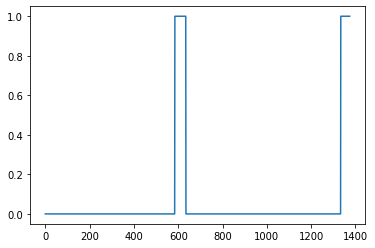

In [23]:
arr1 = insert_ones(np.zeros((1, Ty)), 9700)
plt.plot(insert_ones(arr1, 4251)[0,:])
print("sanity checks:", arr1[0][1333], arr1[0][634], arr1[0][635])

# Implement create_a_training_example function
1. Initialize the label vector $y$ as a numpy array of zeros and shape $(1, T_y)$.
2. Initialize the set of existing segments to an empty list.
3. Randomly select 0 to 4 "activate" audio clips, and insert them onto the 10 second clip. Also insert labels at the correct position in the label vector $y$.
4. Randomly select 0 to 2 negative audio clips, and insert them into the 10 second clip. 


In [24]:

def create_training_example(background, activates, negatives, Ty):
    """
    Creates a training example with a given background, activates, and negatives.
    
    Arguments:
    background -- a 10 second background audio recording
    activates -- a list of audio segments of the word "activate"
    negatives -- a list of audio segments of random words that are not "activate"
    Ty -- The number of time steps in the output

    Returns:
    x -- the spectrogram of the training example
    y -- the label at each time step of the spectrogram
    """
    
    # Make background quieter
    background = background - 20


    #Initialize y (label vector) of zeros 
    y = np.zeros((1, Ty))

    #Initialize segment times as empty list 
    previous_segments = []
    
    # Select 0-4 random "activate" audio clips from the entire list of "activates" recordings
    number_of_activates = np.random.randint(0, 5)
    random_indices = np.random.randint(len(activates), size=number_of_activates)
    random_activates = [activates[i] for i in random_indices]
    

    # Loop over randomly selected "activate" clips and insert in background
    for random_activate in random_activates:
        # Insert the audio clip on the background
        background, segment_time = insert_audio_clip(background, random_activate, previous_segments)
        # Retrieve segment_start and segment_end from segment_time
        segment_start, segment_end = segment_time
        # Insert labels in "y" at segment_end
        y = insert_ones(y, segment_end)


    # Select 0-2 random negatives audio recordings from the entire list of "negatives" recordings
    number_of_negatives = np.random.randint(0, 3)
    random_indices = np.random.randint(len(negatives), size=number_of_negatives)
    random_negatives = [negatives[i] for i in random_indices]

    # Step 4: Loop over randomly selected negative clips and insert in background
    for random_negative in random_negatives:
        # Insert the audio clip on the background 
        background, _ = insert_audio_clip(background, random_negative, previous_segments)
    
    # Standardize the volume of the audio clip 
    background = match_target_amplitude(background, -20.0)

    # Export new training example 
    file_handle = background.export("train" + ".wav", format="wav")
    
    # Get and plot spectrogram of the new recording (background with superposition of positive and negatives)
    x = graph_spectrogram("train.wav")
    
    return x, y

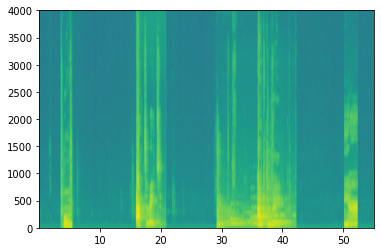

In [26]:

def create_training_example_test(target):
    np.random.seed(18)
    x, y = target(backgrounds[0], activates, negatives, 1375)

create_training_example_test(create_training_example)

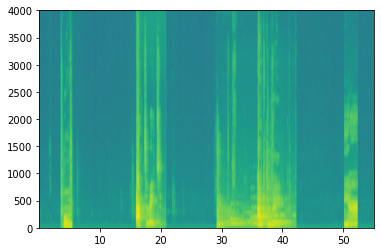

In [27]:
# Set the random seed
np.random.seed(18)
x, y = create_training_example(backgrounds[0], activates, negatives, Ty)

Now we can listen to the training example you created and compare it to the spectrogram generated above.

In [28]:
IPython.display.Audio("train.wav")

In [29]:
IPython.display.Audio("audio_examples/train_reference.wav")

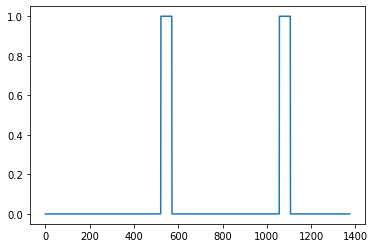

In [30]:
plt.plot(y[0])

0
10
20
30
40
50
60
70
80
90


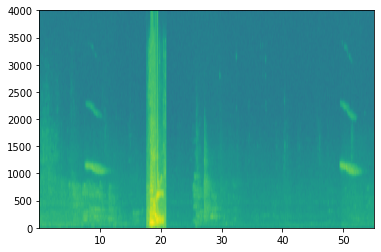

In [44]:

np.random.seed(4543)
nsamples = 100
X = []
Y = []
for i in range(0, nsamples):
    if i%10 == 0:
        print(i)
    x, y = create_training_example(backgrounds[i % 2], activates, negatives, Ty)
    X.append(x.swapaxes(0,1))
    Y.append(y.swapaxes(0,1))
X = np.array(X)
Y = np.array(Y)

In [34]:
 #Save the data for further uses
 np.save(f'./XY_train/X.npy', X)
 np.save(f'./XY_train/Y.npy', Y)
 #Load the preprocessed training examples
 X = np.load("./XY_train/X.npy")
 Y = np.load("./XY_train/Y.npy")


### Development Set

* To test our model, we recorded a development set of 25 examples. 
* While our training data is synthesized, we want to create a development set using the same distribution as the real inputs. 
* Thus, we recorded 25 10-second audio clips of people saying "activate" and other random words, and labeled them by hand. 


In [35]:
# Load preprocessed dev set examples
X_dev = np.load("./XY_dev/X_dev.npy")
Y_dev = np.load("./XY_dev/Y_dev.npy")


## The Model


In [36]:
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.models import Model, load_model, Sequential
from tensorflow.keras.layers import Dense, Activation, Dropout, Input, Masking, TimeDistributed, LSTM, Conv1D
from tensorflow.keras.layers import GRU, Bidirectional, BatchNormalization, Reshape
from tensorflow.keras.optimizers import Adam


### Build the Model

Our goal is to build a network that will ingest a spectrogram and output a signal when it detects the trigger word. This network will use 4 layers:
    * A convolutional layer
    * Two GRU layers
    * A dense layer. 

Here is the architecture we will use.

<img src="images/model.png" style="width:600px;height:600px;">
<center> **Figure 3** </center>

##### 1D convolutional layer
One key layer of this model is the 1D convolutional step (near the bottom of Figure 3). 
* It inputs the 5511 step spectrogram.  Each step is a vector of 101 units.
* It outputs a 1375 step output
* This output is further processed by multiple layers to get the final $T_y = 1375$ step output. 
* This 1D convolutional layer plays a role similar to the 2D convolutions you saw in Course 4, of extracting low-level features and then possibly generating an output of a smaller dimension. 
* Computationally, the 1-D conv layer also helps speed up the model because now the GRU  can process only 1375 timesteps rather than 5511 timesteps. 

##### GRU, dense and sigmoid
* The two GRU layers read the sequence of inputs from left to right.
* A dense plus sigmoid layer makes a prediction for $y^{\langle t \rangle}$. 
* Because $y$ is a binary value (0 or 1), we use a sigmoid output at the last layer to estimate the chance of the output being 1, corresponding to the user having just said "activate".

#### Unidirectional RNN
* Note that we use a **unidirectional RNN** rather than a bidirectional RNN. 
* This is really important for trigger word detection, since we want to be able to detect the trigger word almost immediately after it is said. 
* If we used a bidirectional RNN, we would have to wait for the whole 10sec of audio to be recorded before we could tell if "activate" was said in the first second of the audio clip.  

In [42]:

def modelf(input_shape):
    """
    Function creating the model's graph in Keras.
    
    Argument:
    input_shape -- shape of the model's input data (using Keras conventions)

    Returns:
    model -- Keras model instance
    """
    
    X_input = Input(shape = input_shape)

    
    # CONV layer
    # Add a Conv1D with 196 units, kernel size of 15 and stride of 4
    X = Conv1D(196, 15, strides=4)(X_input)
    # Batch normalization
    X = BatchNormalization()(X)
    # ReLu activation
    X = Activation('relu')(X)
    # dropout (use 0.8)
    X = Dropout(0.8)(X)                                 

    # First GRU Layer
    # GRU (use 128 units and return the sequences)
    X = GRU(units = 128, return_sequences=True)(X)
    # dropout (use 0.8)
    X = Dropout(0.8)(X)
    # Batch normalization.
    X = BatchNormalization()(X)                           
    
    # Second GRU Layer 
    # GRU (use 128 units and return the sequences)
    X = GRU(units = 128, return_sequences=True)(X)
    # dropout (use 0.8)
    X = Dropout(0.8)(X)       
    # Batch normalization
    X = BatchNormalization()(X)
    # dropout (use 0.8)
    X = Dropout(0.8)(X)                                 
    
    # Time-distributed dense layer
    # TimeDistributed  with sigmoid activation 
    X = TimeDistributed(Dense(1, activation = "sigmoid"))(X) 

    model = Model(inputs = X_input, outputs = X)
    
    return model  

In [51]:
Tx = 5511
model2 = modelf(input_shape = (Tx, n_freq))

Let's print the model summary to keep track of the shapes.

In [52]:
model2.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 5511, 101)]       0         
                                                                 
 conv1d_4 (Conv1D)           (None, 1375, 196)         297136    
                                                                 
 batch_normalization_12 (Bat  (None, 1375, 196)        784       
 chNormalization)                                                
                                                                 
 activation_4 (Activation)   (None, 1375, 196)         0         
                                                                 
 dropout_16 (Dropout)        (None, 1375, 196)         0         
                                                                 
 gru_8 (GRU)                 (None, 1375, 128)         125184    
                                                           

The output of the network is of shape (None, 1375, 1) while the input is (None, 5511, 101). The Conv1D has reduced the number of steps from 5511 to 1375. 


### Fit the Model

* Trigger word detection takes a long time to train. 
* Load a pretrained model 
* Let's load the model. 

In [49]:
from tensorflow.keras.models import model_from_json

json_file = open('./models/model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
model = model_from_json(loaded_model_json)
model.load_weights('./models/model.h5')

In [50]:
model.layers[2].trainable = False
model.layers[7].trainable = False
model.layers[10].trainable = False

You can train the model further, using the Adam optimizer and binary cross entropy loss, as follows. This will run quickly because we are training just for two epochs and with a small training set of 32 examples. 

In [53]:
opt = Adam(lr=1e-6, beta_1=0.9, beta_2=0.999)
model2.compile(loss='binary_crossentropy', optimizer=opt, metrics=["accuracy"])

In [54]:
model2.fit(X, Y, batch_size = 16, epochs=1)

7/7 [==============================] - 34s 3s/step - loss: 1.1958 - accuracy: 0.5129



### Test the Model


In [55]:
loss, acc, = model2.evaluate(X_dev, Y_dev)
print("Dev set accuracy = ", acc)

1/1 [==============================] - 3s 3s/step - loss: 0.6151 - accuracy: 0.9189
Dev set accuracy =  0.9189236164093018



## Making Predictions

Now that we have built a working model for trigger word detection, let's use it to make predictions. This code snippet runs audio (saved in a wav file) through the network. 


In [56]:
def detect_triggerword(filename):
    plt.subplot(2, 1, 1)
    
    # Correct the amplitude of the input file before prediction 
    audio_clip = AudioSegment.from_wav(filename)
    audio_clip = match_target_amplitude(audio_clip, -20.0)
    file_handle = audio_clip.export("tmp.wav", format="wav")
    filename = "tmp.wav"

    x = graph_spectrogram(filename)
    # the spectrogram outputs (freqs, Tx) and we want (Tx, freqs) to input into the model
    x  = x.swapaxes(0,1)
    x = np.expand_dims(x, axis=0)
    predictions = model.predict(x)
    
    plt.subplot(2, 1, 2)
    plt.plot(predictions[0,:,0])
    plt.ylabel('probability')
    plt.show()
    return predictions

#### Insert a chime to acknowledge the "activate" trigger


In [57]:
chime_file = "audio_examples/chime.wav"
def chime_on_activate(filename, predictions, threshold):
    audio_clip = AudioSegment.from_wav(filename)
    chime = AudioSegment.from_wav(chime_file)
    Ty = predictions.shape[1]
    # Initialize the number of consecutive output steps to 0
    consecutive_timesteps = 0
    i = 0
    # Loop over the output steps in the y
    while i < Ty:
        # Increment consecutive output steps
        consecutive_timesteps += 1
        # If prediction is higher than the threshold for 20 consecutive output steps have passed
        if consecutive_timesteps > 20:
            # Superpose audio and background using pydub
            audio_clip = audio_clip.overlay(chime, position = ((i / Ty) * audio_clip.duration_seconds) * 1000)
            # Reset consecutive output steps to 0
            consecutive_timesteps = 0
            i = 75 * (i // 75 + 1)
            continue
        # if amplitude is smaller than the threshold reset the consecutive_timesteps counter
        if predictions[0, i, 0] < threshold:
            consecutive_timesteps = 0
        i += 1
        
    audio_clip.export("chime_output.wav", format='wav')


### Test on Dev Examples

Let's explore how our model performs on two unseen audio clips from the development set. Lets first listen to the two dev set clips. 

In [58]:
IPython.display.Audio("./raw_data/dev/1.wav")

In [59]:
IPython.display.Audio("./raw_data/dev/2.wav")

Now lets run the model on these audio clips and see if it adds a chime after "activate"!

1/1 [==============================] - 2s 2s/step


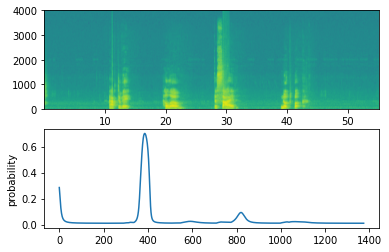

In [60]:
filename = "./raw_data/dev/1.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")

1/1 [==============================] - 0s 422ms/step


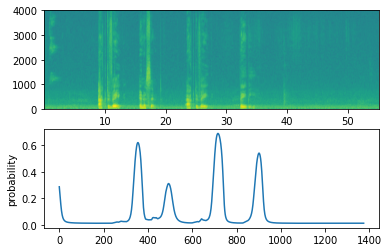

In [61]:
filename  = "./raw_data/dev/2.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")

In [63]:
# Preprocess the audio to the correct format
def preprocess_audio(filename):
    # Trim or pad audio segment to 10000ms
    padding = AudioSegment.silent(duration=10000)
    segment = AudioSegment.from_wav(filename)[:10000]
    segment = padding.overlay(segment)
    # Set frame rate to 44100
    segment = segment.set_frame_rate(44100)
    # Export as wav
    segment.export(filename, format='wav')

In [68]:
your_filename = "D:\\Coursera\\Sequence Models\\testcase.wav"

In [69]:
preprocess_audio(your_filename)
IPython.display.Audio(your_filename) 

C:\Users\DELL\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\matplotlib\axes\_axes.py:7626: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


1/1 [==============================] - 0s 272ms/step


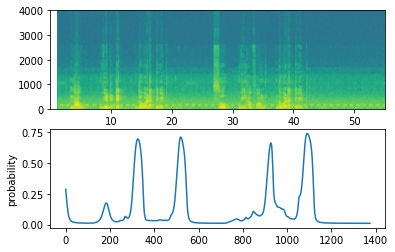

In [70]:
chime_threshold = 0.5
prediction = detect_triggerword(your_filename)
chime_on_activate(your_filename, prediction, chime_threshold)
IPython.display.Audio("./chime_output.wav")

In [79]:
your_filename = "D:\\Coursera\\Sequence Models\\Recording.wav"

In [80]:
preprocess_audio(your_filename)
IPython.display.Audio(your_filename) 

1/1 [==============================] - 0s 301ms/step


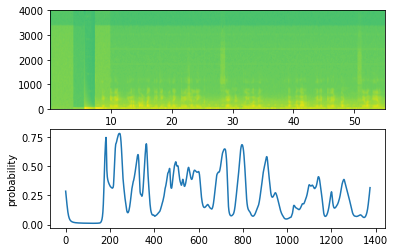

In [81]:
chime_threshold = 0.6
prediction = detect_triggerword(your_filename)
chime_on_activate(your_filename, prediction, chime_threshold)
IPython.display.Audio("./chime_output.wav")

In [76]:
your_filename = "D:\\Coursera\\Sequence Models\\test2.wav"
preprocess_audio(your_filename)
IPython.display.Audio(your_filename) 

C:\Users\DELL\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\matplotlib\axes\_axes.py:7626: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


1/1 [==============================] - 0s 267ms/step


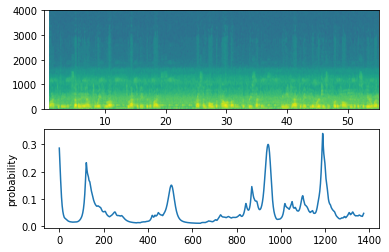

In [77]:
chime_threshold = 0.5
prediction = detect_triggerword(your_filename)
chime_on_activate(your_filename, prediction, chime_threshold)
IPython.display.Audio("./chime_output.wav")